In [1]:
%matplotlib inline
import os
import multiprocessing

import scipy
import numpy as np
import pandas as pd

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import RandomizedSearchCV as CV

from pymatgen.io.vasp import Poscar
from pymatgen.io.ase import AseAtomsAdaptor

from ase.visualize import view
from sklearn.svm import SVR
#from thundersvm import SVR # much faster with GPU support

def tw(iterable, **kwargs):
    "Add a progress bar using tqdm if available"
    try:
        import tqdm
        tqdm.tqdm._instances.clear()
        # clear existing instances
    except AttributeError:
        pass
    try:
        return tqdm.tqdm_notebook(iterable, **kwargs)
    except NameError:
        return iterable  # could not import tqdm

n_cores = multiprocessing.cpu_count()

# directory of POSCARs and energy files
working_directory = '/home/jason/Downloads'
directory_path = working_directory + "/CdTe_Archive/"

structure_ext = 'poscar'  #file extension names
target_ext = 'energy'

element_list = ['Cd', 'Te']  # list of elements to consider

def process_entry(args):
    """parse files"""
    entry_name, element_list, directory_path, structure_ext, target_ext = args
    target_file = '{}/{}.{}'.format(directory_path,
                                    entry_name,
                                    target_ext)
    with open(target_file) as f:
        lines = f.read().splitlines()
    local_energies = [float(line) for line in lines]
    # This dataset has per-atom energies but we won't use them
    energy = np.sum(local_energies)
    
    structure_file = '{}/{}.{}'.format(directory_path,
                                       entry_name,
                                       structure_ext)
    structure = Poscar.from_file(structure_file).structure
    entry_data = [len(structure), energy]
    for element in element_list:
        element_percent = structure.composition.get_atomic_fraction(element)
        entry_data.append(element_percent)
    return structure, entry_data


In [2]:

file_stems = [os.path.splitext(f)[0]
              for f in os.listdir(directory_path) 
              if structure_ext in f]
# check the working directory for files matching the ext

columns = ['Size', 'Total Energy'] + element_list  # pandas header

# prepare zipped arguments for parallel parsing
zipped_args = [(f, element_list, directory_path, structure_ext, target_ext)
               for f in file_stems]
parsed_data = list(tw(multiprocessing.Pool(n_cores).imap(process_entry,
                                                         zipped_args),
                      total=len(zipped_args)))

In [5]:
#print((structur
#e_list[:].composition))
#print(table_data)

In [6]:
structure_list, table_data = zip(*parsed_data)
structures = {k: v for k, v in zip(file_stems, structure_list)}
df = pd.DataFrame(columns=columns, data=table_data, index=file_stems)

In [7]:
comp = []
struc = []
for a in structure_list:
    struc.append(a)
    comp.append((a.composition))

In [11]:
df['composition'] = comp 
df['structure'] = struc
df.head()
df.keys()

'Size'

In [9]:
reference_energies = {}
for element in element_list:
    pure_entries = df[df[element] == 1.0]
    pure_entry_energies = pure_entries['Total Energy'].values
    pure_entry_energies /= pure_entries['Size'].values
    minimum_energy = np.min(pure_entry_energies)
    reference_energies[element] = minimum_energy

In [28]:
def get_formation_energy(entry_data, element_list, reference_energies):
    element_fractions = {element: entry_data[element] 
                         for element in element_list}
    reference_contributions = [(reference_energies[element] 
                               * element_fractions[element])
                               for element in element_list]
    formation_energy = (entry_data['Total Energy']/entry_data['Size'] 
                        - np.sum(reference_contributions))
    return formation_energy

df['Formation Energy'] = df.apply(get_formation_energy, axis=1, 
                                  args=(element_list, reference_energies))
df = df.drop(['Cd', 'Te','Total Energy', 'Size'], axis =1)
df.head()



,composition,structure,Formation Energy
9395,"(Te, Cd)","[[3.74463814 9.13528893 2.67318613] Te, [1.730...",0.013579
1422,"(Cd, Te)","[[1.02235479 2.20744654 7.38043413] Cd, [ 1.99...",0.097101
1263,(Cd),"[[1.26831532 5.84922484 7.19371357] Cd, [3.672...",0.143174
8155,"(Cd, Te)","[[1.7245267 0.26878082 0.49605161] Cd, [-0.55...",0.041126
2082,"(Te, Cd)","[[3.74421624 6.35227058 5.18990281] Te, [4.348...",0.121023


In [29]:
from sklearn.model_selection import train_test_split

train_df, test_df = train_test_split(df, test_size=0.2, shuffle=True, random_state=20191014)

In [30]:
from automatminer import MatPipe

pipe = MatPipe.from_preset("express")

In [31]:
target = 'Formation Energy'
actual_form = test_df[target]
prediction_df = test_df.drop(columns=[target])
prediction_df.head()

,composition,structure
1199,"(Cd, Te)","[[3.25580751 1.40914057 5.38002114] Cd, [3.219..."
5826,"(Te, Cd)","[[0.88906329 7.3127953 4.70815425] Te, [3.223..."
1304,(Cd),"[[ 3.68928666 9.21987121 15.5985304 ] Cd, [1...."
6489,"(Te, Cd)","[[0.27594099 0.80693691 6.11620791] Te, [ 2.53..."
3553,"(Te, Cd)","[[-1.63369658 -0.06158857 8.35937477] Te, [ 0..."


In [20]:
%%timeit
pipe.fit(train_df, target)

2020-07-31 11:42:53 INFO     Problem type is: regression
2020-07-31 11:42:53 INFO     Fitting MatPipe pipeline to data.
2020-07-31 11:42:53 INFO     AutoFeaturizer: Starting fitting.
2020-07-31 11:42:53 INFO     AutoFeaturizer: composition column already exists, overwriting with composition from structure.
2020-07-31 11:42:53 INFO     AutoFeaturizer: Guessing oxidation states of structures if they were not present in input.



2020-07-31 11:43:32 INFO     AutoFeaturizer: Guessing oxidation states of compositions, as they were not present in input.



2020-07-31 11:43:35 INFO     AutoFeaturizer: Will remove YangSolidSolution because it's fraction passing the precheck for this dataset (0.08105939004815409) was less than the minimum (0.9)
2020-07-31 11:43:37 INFO     AutoFeaturizer: Will remove Miedema because it's fraction passing the precheck for this dataset (0.08105939004815409) was less than the minimum (0.9)
2020-07-31 11:43:37 INFO     AutoFeaturizer: Guessing oxidation states of structures if they were not present in input.



2020-07-31 11:44:02 INFO     AutoFeaturizer: Will remove GlobalInstabilityIndex because it's fraction passing the precheck for this dataset (0.3817549491706795) was less than the minimum (0.9)
2020-07-31 11:44:02 INFO     AutoFeaturizer: Featurizer type bandstructure not in the dataframe to be fitted. Skipping...
2020-07-31 11:44:02 INFO     AutoFeaturizer: Featurizer type dos not in the dataframe to be fitted. Skipping...
2020-07-31 11:44:02 INFO     AutoFeaturizer: Finished fitting.
2020-07-31 11:44:02 INFO     AutoFeaturizer: Starting transforming.
2020-07-31 11:44:02 INFO     AutoFeaturizer: Featurizing with ElementProperty.



2020-07-31 11:44:17 INFO     AutoFeaturizer: Featurizing with OxidationStates.



2020-07-31 11:44:18 INFO     AutoFeaturizer: Featurizing with ElectronAffinity.



2020-07-31 11:44:19 INFO     AutoFeaturizer: Featurizing with IonProperty.



2020-07-31 11:44:20 INFO     AutoFeaturizer: Featurizing with DensityFeatures.



2020-07-31 11:44:27 INFO     AutoFeaturizer: Featurizing with GlobalSymmetryFeatures.



2020-07-31 11:44:32 INFO     AutoFeaturizer: Featurizing with EwaldEnergy.



2020-07-31 11:44:51 INFO     AutoFeaturizer: Featurizing with SineCoulombMatrix.



2020-07-31 11:44:58 INFO     AutoFeaturizer: Featurizing with StructuralComplexity.



2020-07-31 11:45:04 INFO     AutoFeaturizer: Featurizer type bandstructure not in the dataframe. Skipping...
2020-07-31 11:45:04 INFO     AutoFeaturizer: Featurizer type dos not in the dataframe. Skipping...
2020-07-31 11:45:04 INFO     AutoFeaturizer: Finished transforming.
2020-07-31 11:45:04 INFO     DataCleaner: Starting fitting.
2020-07-31 11:45:04 INFO     DataCleaner: Cleaning with respect to samples with sample na_method 'drop'
2020-07-31 11:45:04 INFO     DataCleaner: Replacing infinite values with nan for easier screening.
2020-07-31 11:45:04 INFO     DataCleaner: One-hot encoding used for columns ['crystal_system']
2020-07-31 11:45:04 INFO     DataCleaner: Before handling na: 3738 samples, 175 features
2020-07-31 11:45:04 INFO     DataCleaner: 0 samples did not have target values. They were dropped.
2020-07-31 11:45:04 INFO     DataCleaner: Handling feature na by max na threshold of 0.01 with method 'drop'.
2020-07-31 11:45:04 INFO     DataCleaner: These 1 features were rem

Generation 1 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	-0.03709944922919762	RandomForestRegressor(MaxAbsScaler(VarianceThreshold(input_matrix, VarianceThreshold__threshold=0.0005)), RandomForestRegressor__bootstrap=False, RandomForestRegressor__max_features=0.35000000000000003, RandomForestRegressor__min_samples_leaf=7, RandomForestRegressor__min_samples_split=14, RandomForestRegressor__n_estimators=1000)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)

_pre_test decorator: _random_mutation_operator: num_test=0 X contai

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Generation 5 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=39, KNeighborsRegresso

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 6 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=12, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.001), Nystroem__gamma=0.4, Nystro

_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Generation 7 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.002), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor_

Generation 8 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=7), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.5, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.005), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighbors

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Generation 9 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0

Generation 10 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=4), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystr

Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 11 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.018000000000000002), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=39, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__

_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Generation 12 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=uniform)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.6000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
Generation 13 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=46, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), N

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Generation 14 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=uniform)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegr

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Generation 15 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.1, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.013000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, Se

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 16 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.017), Nystroem__gamma

Generation 17 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=1.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.9, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=62, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighbor

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
Generation 18 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 19 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_compon

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 20 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=7, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neigh

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
Generation 21 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=8), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=69, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=50, KNeighborsRegresso

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
Generation 22 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=1, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=55, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	n

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 23 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=95, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_componen

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Generation 24 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3

Generation 25 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=52, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=71, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=8), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroe

Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 26 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=8), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=7), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=1.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s)

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
Generation 28 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.9, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=39, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRe

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.15000000000000002, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=uniform)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=uniform)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=7), KNeighborsRegressor__n_neighbors=32, KNei

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 29 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.016), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 30 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=45, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Ny

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evalu

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=10, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=uniform)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbo

Generation 32 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.027), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=17, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=77, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystr

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 33 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=91, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.5, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.005), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=97, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=10, K

Generation 34 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.027), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=64, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 35 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=7), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.1, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighb

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 36 - Current Pareto front scores:
-3	nan	KNeighbors

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Usin

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=uniform)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNe

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 38 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=1.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.2, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 39 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_m

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=39, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=25, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=56, KN

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
Pipeline encountered that has previously been evalua

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.9, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=60, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsReg

Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 41 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=6), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=36, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nys

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.2, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNe

_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 42 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=48, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsR

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 43 - Current Pareto front scores:
-3	nan	KNeig

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=54, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.9, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decora

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=83, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.002), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decora

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=70, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=8), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=11, KNeighbor

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=uniform)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=9), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.013000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNei

Generation 46 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=84, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighbor

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=12, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=6), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=3, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=25, KNei

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.1, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.30000000000000004, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=1.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_n

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 48 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegresso

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
Generation 49 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectF

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.05, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=8), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=89, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, K

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 50 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=7, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	K

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.6000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=89, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.017), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighb

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.016), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegres

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=54, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=81, KNeighborsRegresso

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=91, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.014), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, K

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decora

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.005), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=10, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegre

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.023), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=44, KNeighb

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contain

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.005), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.30000000000000004, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=50, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegresso

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 55 - Current Pareto front scores:
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Ny

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.003), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=3), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=9), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=46, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.1, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegresso

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=5 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0))

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=100, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=86, KNeighborsRegres

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.05, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.029), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.2, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegr

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=3, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=69, KNeighborsRegressor__p=1, KNeighbor

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighbo

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=65, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=99, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=11, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=7), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=8), KNeighborsRegressor__n_n

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contain

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=10, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.016), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=17, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNei

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decora

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=58, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.1, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=7), KNeighborsRegressor__n_neighbors=56, KNeighbors

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neig

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=98, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=39, KNeighborsRegres

_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..


-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=9), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=56, KN

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=4), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=74, KNeighborsRegressor__p=1

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contain

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.30000000000000004, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=1.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=73, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_n

_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0))

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=36, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=59, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=89, KNeighborsRegress

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=85, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=60, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=1.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.9, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNe

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decora

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.55, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=92, KNeighborsRegre

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.75, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=91, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRe

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=23, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=70, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighbor

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=7), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=22, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=27, KN

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegresso

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=62, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.011), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neigh

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=95, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=16, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.75, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegress

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encount

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=71, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=4, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.15000000000000002, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KN

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Generation 67 - Current Pareto front scores:
-3	nan	KNeig

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.9500000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=42, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=97, KNe

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.55, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.30000000000000004, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighbo

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
Pipeline encountered that has previously been evaluated during the o

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=6), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.9, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=39, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.6000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbo

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.017), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=98, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegress

_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=5 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=6 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..


-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=33, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.5, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=63, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbo

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=1.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.15000000000000002, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=32, KNe

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=62, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=8), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighb

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutat

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=9, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.015), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_n

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=85, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=68, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.2, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=82, KNeighborsRegress

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=3 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decora

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=8), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=3), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_nei

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=36, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.75, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.005), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.30000000000000004, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsReg

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decora

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=21, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=31, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.005), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.75, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeigh

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contain

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.023), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=5, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=35, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=2, KNeighborsRegressor__p=1, KNeighbor

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=8), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=69, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=50, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.9, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighbor

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decora

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.002), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=41, KNeighborsRegres

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=30, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.016), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=1, KNeighborsRegresso

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decora

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=36, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=21, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=11, K

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.9500000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=1, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.023), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeig

_pre_test decorator: _random_mutation_operator: num_test=5 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=6 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=34, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=16, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=52, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=71, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.8500000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, K

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encount

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=92, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=100, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsReg

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=23, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=70, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighbor

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=8, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=uniform)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeig

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=70, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=10, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegr

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=55, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=6), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=24, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=3), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.006), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegresso

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=68, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.2, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=82, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=1, KNeighborsRegressor__p=1, KNeighbo

_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=6), KNeighborsRegressor__n_neighbors=56, KNeighborsRegre

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=16, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=67, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.02), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.8500000000000001, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.001), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.5, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegr

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decora

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=91, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=64, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.05, Nystroem__kernel=chi2, Nystroem__n_components=1

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.2, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=82, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=1, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1,

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the 

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.30000000000000004, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.018000000000000002), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=36, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighb

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.2, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, 

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegresso

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=58, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=7, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_ne

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=35, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=69, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=92, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=81, KN

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=uniform)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=7), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.5, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.005), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegresso

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=5 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=6 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=7 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.027), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.2, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighb

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=23, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=55, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=6), KNeighborsRegressor_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=4), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=6, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=6), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighbors

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.5, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.005), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=97, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=10, K

_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline encountered that has previously been evaluated during the optimization process. Using the score from the previous evaluation.
Pipeline e

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=23, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.013000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=93, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.30000000000000004, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_n

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=3), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.006), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=12, KNeighborsRegress

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=71, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.8500000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=36, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=7), KNeighborsRegressor__n_neighbors=56, KNe

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=5 X contain

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=40, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=88, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=58, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=9), KNeighborsRegre

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=1, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=8, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor_

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=5 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=6 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=7 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=8 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.9500000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=64, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.031), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.012), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=uniform)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.017), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.25, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=uniform)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=49, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.008), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighb

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found arr

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.023), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=5, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=35, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=2, KNeighborsRegressor__p=1, KNeighbor

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.023), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=44, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=7), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=13, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=10, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=38, K

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=27, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.015), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=70, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=3), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=uniform)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.027), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KN

_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contain

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.2, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=4, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.031), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighbors

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.014), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.005), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=97, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=78, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=59, KNe

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=40, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.011), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.027), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighbo

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.8, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=84, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.015), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_compon

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=65, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=12, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=10), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegres

_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..


-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=93, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.0, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KN

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=48, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=85, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=40, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeig

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=5 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=6 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0))

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=8), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=4), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegr

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=16, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=52, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=34, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=8, KN

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=6), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=95, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=74, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=13, KNeighborsRegresso

_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=5 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=6 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=7 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=8 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=9 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decora

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=36, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=13, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=10, K

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.75, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=16, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=67, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.02), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighbo

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.001), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=5), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.5, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegr

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mut

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=13, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=8, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KN

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=45, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=76, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.016), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, K

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=83, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.002), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=5 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.023), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=51, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=77, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, K

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.017), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=8), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=49, KN

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=3), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=41, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.05, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.012), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, 

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.6000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.005), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighbors

_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decora

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=13, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=55, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=39, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, K

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=48, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=85, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=40, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeig

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.45, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNe

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.75, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=83, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=18, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=82, KNeighborsRegresso

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.6000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.8, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=38, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=8, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.021), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=99, KNe

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=20, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.05, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=59, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.011), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, K

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.018000000000000002), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.9500000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.029), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_ne

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=5 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=6 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=47, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.005), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=41, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=48, KNe

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=95, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=74, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=13, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=12, KNeighborsRegressor

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=36, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=7), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=22, KN

_pre_test decorator: _random_mutation_operator: num_test=0 Found array with 0 feature(s) (shape=(50, 0)) while a minimum of 1 is required..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=2 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=3 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=4 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=1 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contains negative values..
_pre_test decorator: _random_mutation_operator: num_test=0 X contain

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=55, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.024), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=32, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=7), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=33, 

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.1, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=79, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.55, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.35000000000000003, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=31, K

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.02), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.55, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.65, Nystroem__kernel=chi2, Nystroem__n_components=2), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=50, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=6), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.022), Nystroem__gamma=0.45, Nystroem__kernel=additive_chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighb

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=35, KNeighborsRegressor__p=2, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=81, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.025), Nystroem__gamma=0.7000000000000001, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=83, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.01), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor_

-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.004), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.019), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)
-3	nan	KNeighborsRegressor(Nystroem(SelectFwe(input_matrix, SelectFwe__alpha=0.009000000000000001), Nystroem__gamma=0.4, Nystroem__kernel=chi2, Nystroem__n_components=1), KNeighborsRegressor__n_neighbors=56, KNeighborsRegressor__p=1, KNeighborsRegressor__weights=distance)



ValueError: X contains negative values.

In [14]:
prediction_df = pipe.predict(prediction_df)

2020-07-31 11:20:57 INFO     Beginning MatPipe prediction using fitted pipeline.
2020-07-31 11:20:57 INFO     AutoFeaturizer: Starting transforming.
2020-07-31 11:20:57 INFO     AutoFeaturizer: composition column already exists, overwriting with composition from structure.
2020-07-31 11:20:57 INFO     AutoFeaturizer: Guessing oxidation states of structures if they were not present in input.



2020-07-31 11:21:08 INFO     AutoFeaturizer: Guessing oxidation states of compositions, as they were not present in input.



2020-07-31 11:21:08 INFO     AutoFeaturizer: Featurizing with ElementProperty.



2020-07-31 11:21:13 INFO     AutoFeaturizer: Guessing oxidation states of structures if they were not present in input.



2020-07-31 11:21:15 INFO     AutoFeaturizer: Featurizing with SineCoulombMatrix.



2020-07-31 11:21:17 INFO     AutoFeaturizer: Featurizer type bandstructure not in the dataframe. Skipping...
2020-07-31 11:21:17 INFO     AutoFeaturizer: Featurizer type dos not in the dataframe. Skipping...
2020-07-31 11:21:17 INFO     AutoFeaturizer: Finished transforming.
2020-07-31 11:21:17 INFO     DataCleaner: Starting transforming.
2020-07-31 11:21:17 INFO     DataCleaner: Cleaning with respect to samples with sample na_method 'fill'
2020-07-31 11:21:17 INFO     DataCleaner: Replacing infinite values with nan for easier screening.
2020-07-31 11:21:17 INFO     DataCleaner: Before handling na: 935 samples, 150 features
2020-07-31 11:21:17 INFO     DataCleaner: After handling na: 935 samples, 150 features
2020-07-31 11:21:17 INFO     DataCleaner: Target not found in df columns. Ignoring...
2020-07-31 11:21:17 INFO     DataCleaner: Finished transforming.
2020-07-31 11:21:17 INFO     FeatureReducer: Starting transforming.
2020-07-31 11:21:17 WARNING  FeatureReducer: Target not found

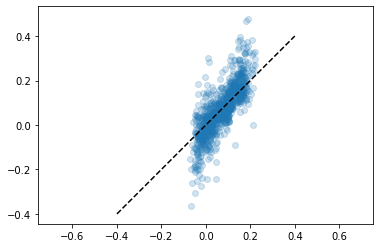

In [15]:
import matplotlib.pyplot as plt

x=(np.array(prediction_df['Formation Energy predicted']))
plt.scatter(x, actual_form, alpha=0.2)
plt.plot([-0.4, 0.4], [-0.4, 0.4], 'k--')
plt.axis('equal')
plt.show()

In [16]:
print(pipe.learner.best_pipeline)
print(pipe.autofeaturizer.featurizers["composition"])
print(pipe.autofeaturizer.featurizers["structure"])

Pipeline(memory=Memory(location=/tmp/tmpe7e5r70x/joblib),
         steps=[('selectpercentile',
                 SelectPercentile(percentile=95,
                                  score_func=<function f_regression at 0x7f89041e67a0>)),
                ('zerocount', ZeroCount()),
                ('gradientboostingregressor',
                 GradientBoostingRegressor(alpha=0.85, ccp_alpha=0.0,
                                           criterion='friedman_mse', init=None,
                                           learning_rate=0.01, loss='huber',
                                           max_depth=9, max_features=0.1,
                                           max_leaf_nodes=None,
                                           min_impurity_decrease=0.0,
                                           min_impurity_split=None,
                                           min_samples_leaf=4,
                                           min_samples_split=5,
                                           min

In [17]:
filename = "2test.p"
pipe.save(filename)

In [ ]:
!ls